<table>
<tr>    
<td style="text-align: center">
<h1>Convolutional Neural Networks CNN</h1>
<h2><a href="http://home.agh.edu.pl/~horzyk/index.php">Adrian Horzyk</a></h2>
</td> 
<td>
<img src="http://home.agh.edu.pl/~horzyk/im/AdrianHorzyk49BT140h.png" alt="Adrian Horzyk, Professor" title="Adrian Horzyk, Professor" />        
</td> 
</tr>
</table>
<h3><i>Welcome to the interactive lecture and exercises where you can check everything by yourself and experiment!</i></h3>

# Convolutional Neural Networks

became very popular because they can efficiently deal with many problems, especially with images that can be correctly recognized or classified independently of the movements of objects in the vision area, which was a big limitations of MLP networks (Dense layers only). 

Convolutional Neural Networks (CNN) can hierarchically extract important subpatterns, which are used to define high-order features that allow dense layers to classify input images with more ease and accuracy.

Now, we will try to train such networks using the MNIST dataset to check whether we can achieve better performance and accuracy of the CNN-based models in comparison to the previous MLP (dense layers only) models.

In [35]:
'''Trains a simple ConvNet on the MNIST dataset. It gets over 99.6% validation accuracy after ~50 epochs
(but there is still a margin for hyperparameter tuning). Training can take an hour or so!'''

# Import libraries
from __future__ import print_function
import numpy as np
import math
from math import ceil
import tensorflow as tf
import os   
import seaborn as sns
import matplotlib.pyplot as plt  # library for plotting math functions
import pandas as pd
import keras   # Import keras framework with various functions, models and structures
from keras.datasets import mnist # gets MNIST dataset from repository
from keras import layers
from keras import models
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D
from keras import backend as K
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import ReduceLROnPlateau
from sklearn import metrics
from sklearn.metrics import classification_report
from keras.datasets import mnist
import tensorflow

# Set parameters for plots
%matplotlib inline
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

print ("TensorFlow version: " + tf.__version__)
print ("Keras version:" + keras.__version__)

TensorFlow version: 2.4.1
Keras version:2.4.3


In [2]:
import numpy as np
np.__version__

'1.23.4'

In [36]:
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

Num GPUs Available:  1


In [4]:
!nvidia-smi

Wed Mar 13 19:50:12 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.161.07             Driver Version: 535.161.07   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce MX150           On  | 00000000:01:00.0 Off |                  N/A |
| N/A   42C    P8              N/A / ERR! |      6MiB /  2048MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [5]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 5363104315073388803
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 1708785664
locality {
  bus_id: 1
  links {
  }
}
incarnation: 16090321731101650600
physical_device_desc: "device: 0, name: NVIDIA GeForce MX150, pci bus id: 0000:01:00.0, compute capability: 6.1"
]


2024-03-13 19:50:53.974155: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-03-13 19:50:53.983050: I tensorflow/compiler/jit/xla_gpu_device.cc:99] Not creating XLA devices, tf_xla_enable_xla_devices not set
2024-03-13 19:50:53.983284: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2024-03-13 19:50:53.983472: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: NVIDIA GeForce MX150 computeCapability: 6.1
coreClock: 1.341GHz coreCount: 3 deviceMemorySize: 1.95GiB deviceMemoryBandwidth: 37.33GiB/s


### Create or choose directory for storing trained models.

In [2]:
import os

# The path to the directory for storing and loading our models
models_dir = './models/'
if not os.path.exists(models_dir):
    os.mkdir(models_dir)
    
# The path to the directory where the dataset are stored
original_dataset_dir = './data/'

In [7]:
# Split the data between train and validation sets. Here we are using only two sets for model training and validation.
(x_train, y_train), (x_val, y_val) = mnist.load_data() # 60000 training and 10000 validating examples

# Number of training and val data
num_train_data = x_train.shape[0]
num_val_data = x_val.shape[0]

# Input image dimensions
img_rows, img_cols = x_train.shape[1], x_train.shape[2]

num_classes = np.size(np.unique(y_train))    # number of unique labels = number of classes of digits: 0, 1, 2, ..., 9
print ('Number of classes: ', num_classes)

## Distribution of the numbers training data of various classes
print ('Distribution of the numbers training data of various classes: ', np.unique(y_train, return_counts=True))

## Distribution of the numbers training data of various classes
print ('Distribution of the numbers validation data of various classes: ', np.unique(y_val, return_counts=True))

Number of classes:  10
Distribution of the numbers training data of various classes:  (array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=uint8), array([5923, 6742, 5958, 6131, 5842, 5421, 5918, 6265, 5851, 5949]))
Distribution of the numbers validation data of various classes:  (array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=uint8), array([ 980, 1135, 1032, 1010,  982,  892,  958, 1028,  974, 1009]))


A few examples of the MNIST data:

<Figure size 250x250 with 0 Axes>

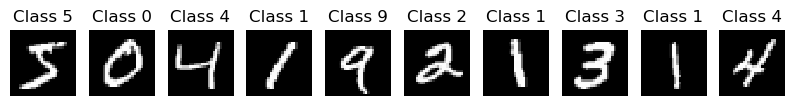

<Figure size 100x100 with 0 Axes>

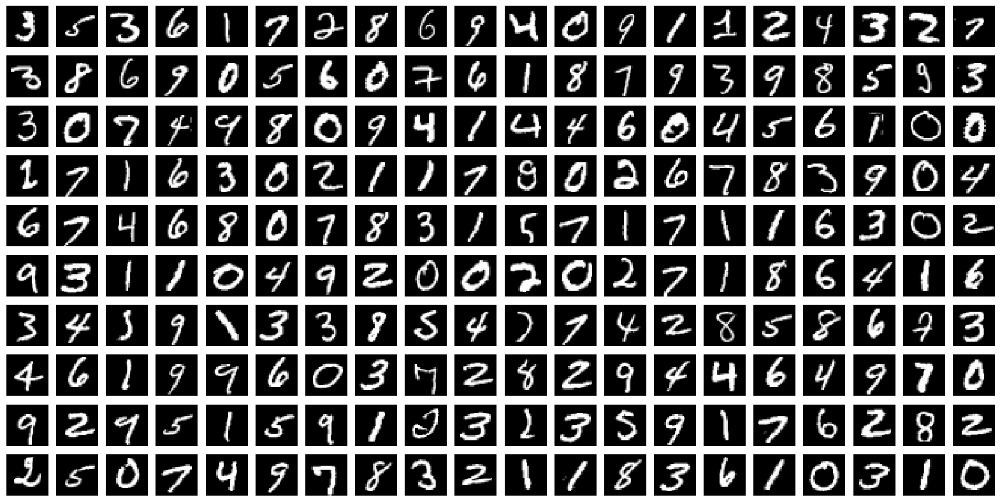

In [8]:
# Show a few sample digits from the training set
plt.figure(figsize=(2.5,2.5))
col1 = 10
row1 = 1
fig = plt.figure(figsize=(col1, row1))
for index in range(0, col1*row1):
    fig.add_subplot(row1, col1, index + 1)
    plt.axis('off')
    plt.imshow(x_train[index]) # index of the sample picture
    plt.title("Class " + str(y_train[index]))
plt.show()

# Show a few sample digits from the training set
plt.figure(figsize=(1.0,1.0))
col2 = 20
row2 = 10
fig = plt.figure(figsize=(col2, row2))
for index in range(col1*row1, col1*row1 + col2*row2):
    fig.add_subplot(row2, col2, index - col1*row1 + 1)
    plt.axis('off')
    plt.imshow(x_train[index]) # index of the sample picture
plt.show()

Reshape and transform the data to the expected types and ranges:

In [9]:
# According to the different formats reshape training and validation data
if K.image_data_format() == 'channels_first':
    x_train = x_train.reshape(x_train.shape[0], 1, img_rows, img_cols)
    x_val = x_val.reshape(x_val.shape[0], 1, img_rows, img_cols)
    input_shape = (1, img_rows, img_cols)
else:
    x_train = x_train.reshape(x_train.shape[0], img_rows, img_cols, 1)
    x_val = x_val.reshape(x_val.shape[0], img_rows, img_cols, 1)
    input_shape = (img_rows, img_cols, 1)
    
# Transform training and validating data and show their shapes
x_train = x_train.astype('float32')   # Copy this array and cast it to a specified type
x_val = x_val.astype('float32')     # Copy this array and cast it to a specified type
x_train /= 255   # Transfrom the training data from the range of 0 and 255 to the range of 0 and 1
x_val /= 255    # Transfrom the validation data from the range of 0 and 255 to the range of 0 and 1

print('x_train shape:', x_train.shape)
print(x_train.shape[0], 'train samples')
print(x_val.shape[0], 'validation samples')

# Convert class vectors (integers) to binary class matrices using as specific 
y_train = tensorflow.keras.utils.to_categorical(y_train, num_classes) # y_train - a converted class vector into a matrix (integers from 0 to num_classes)
y_val = tensorflow.keras.utils.to_categorical(y_val, num_classes) # y_val - a converted class vector into a matrix (integers from 0 to num_classes)

x_train shape: (60000, 28, 28, 1)
60000 train samples
10000 validation samples


## Introduction to ConvNets

First, let's take a look at a very simple convnet example. We will use a convnet to classify MNIST digits, a task that you've already been that we already mentioned and achieved the validation accuracy ~98%). Even though our first convnet will be very basic, its accuracy will outperform the previous densely-connected model.

To construct a basic convnet, we use a small stack of `Conv2D` and `MaxPooling2D` layers.

This convnet takes as input tensors of shape `(image_height, image_width, image_channels)` (not including the batch dimension). We will configure our convnet to process inputs of size `(28, 28, 1)` via passing the argument `input_shape=(28, 28, 1)` to our first layer.

In [10]:
# A simple CONVNET model for MNIST data
model1 = models.Sequential()
model1.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(img_rows, img_cols, 1)))
model1.add(layers.MaxPooling2D((2, 2)))
model1.add(layers.Conv2D(64, (3, 3), activation='relu'))
model1.add(layers.MaxPooling2D((2, 2)))
model1.add(layers.Conv2D(64, (3, 3), activation='relu'))
# Flatten the output to input data to the Dense layer
model1.add(layers.Flatten())
# Dense layers - similar to the previous model, but using the smaller number of units
model1.add(layers.Dense(64, activation='relu'))
model1.add(layers.Dense(num_classes, activation='softmax'))

model1.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 26, 26, 32)        320       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 13, 13, 32)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 11, 11, 64)        18496     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 5, 5, 64)          0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 3, 3, 64)          36928     
_________________________________________________________________
flatten (Flatten)            (None, 576)               0         
_________________________________________________________________
dense (Dense)                (None, 64)                3

2024-03-13 19:51:56.966342: I tensorflow/compiler/jit/xla_gpu_device.cc:99] Not creating XLA devices, tf_xla_enable_xla_devices not set
2024-03-13 19:51:56.966544: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2024-03-13 19:51:56.966711: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: NVIDIA GeForce MX150 computeCapability: 6.1
coreClock: 1.341GHz coreCount: 3 deviceMemorySize: 1.95GiB deviceMemoryBandwidth: 37.33GiB/s
2024-03-13 19:51:56.966741: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2024-03-13 19:51:56.966773: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublas.so.10
2024-03-13 19:51:56.966792: I tensorflow/stream_executor/platform/defa

You can notice that the output of every `Conv2D` and `MaxPooling2D` layer is a 3D tensor of shape `(height, width, channels)`. The width and height dimensions tend to shrink as we go deeper in the network. The number of channels is controlled by the first argument (hyperparameter) passed to the `Conv2D` layers (e.g., 32 or 64), and it is set by the developer (i.e., it is not automatically optimized by the model).

The next step would be to feed our last output tensor (of shape `(3, 3, 64)`) into a densely-connected classifier network like those you are already familiar with - a stack of `Dense` layers, but the dense classifiers require a vector (1D tensor) on its input, so we must flatten our 3D outputs to 1D first, and then add a few `Dense` layers.

As you can see, our `(3, 3, 64)` outputs were flattened into vectors of shape `(576,)`, before going through two `Dense` layers.

Let's notice that our previous dense-based model had about 4 times more parameters (weights) that the above convnet model!

This means that "more is better" not always, but here more can often mean worse, as it leads to overfitting of models.

Now, let's train our convnet on the MNIST digits and compare results:

In [11]:
# Set up the basic hyperparameters
epochs = 50       # the number of training epochs
batch_size = 256  # the size of mini-batches used for training the network in one step

#early_stopping = EarlyStopping(monitor='val_loss', patience=2)
#model.fit(x, y, validation_split=0.2, callbacks=[early_stopping])

model1.compile(optimizer='rmsprop',
                loss='categorical_crossentropy',
                metrics=['acc'])

# Save weights of the model before training to enable to start training it again
model1.save_weights(models_dir + 'CNN_MNIST_1_weights_init.h5')

history1 = model1.fit(x_train, y_train, epochs = epochs, batch_size = batch_size, validation_data=(x_val, y_val))

Epoch 1/50


2024-03-13 19:51:57.097593: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 188160000 exceeds 10% of free system memory.
2024-03-13 19:51:57.233709: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:116] None of the MLIR optimization passes are enabled (registered 2)
2024-03-13 19:51:57.237149: I tensorflow/core/platform/profile_utils/cpu_utils.cc:112] CPU Frequency: 1999965000 Hz
2024-03-13 19:51:57.747570: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublas.so.10
2024-03-13 19:51:57.992938: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudnn.so.7
2024-03-13 19:51:58.670577: W tensorflow/stream_executor/gpu/asm_compiler.cc:63] Running ptxas --version returned 256
2024-03-13 19:51:58.719397: W tensorflow/stream_executor/gpu/redzone_allocator.cc:314] Internal: ptxas exited with non-zero error code 256, output: 
Relying on driver to perform ptx c

235/235 [==============================] - ETA: 0s - loss: 0.7278 - acc: 0.7708

2024-03-13 19:52:15.192720: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 31360000 exceeds 10% of free system memory.


235/235 [==============================] - 21s 60ms/step - loss: 0.7262 - acc: 0.7713 - val_loss: 0.1270 - val_acc: 0.9590
Epoch 2/50
235/235 [==============================] - 6s 24ms/step - loss: 0.0872 - acc: 0.9731 - val_loss: 0.0905 - val_acc: 0.9718
Epoch 3/50
235/235 [==============================] - 6s 23ms/step - loss: 0.0521 - acc: 0.9842 - val_loss: 0.0675 - val_acc: 0.9785
Epoch 4/50
235/235 [==============================] - 6s 23ms/step - loss: 0.0390 - acc: 0.9882 - val_loss: 0.0277 - val_acc: 0.9907
Epoch 5/50
235/235 [==============================] - 5s 23ms/step - loss: 0.0280 - acc: 0.9913 - val_loss: 0.0390 - val_acc: 0.9876
Epoch 6/50
235/235 [==============================] - 6s 24ms/step - loss: 0.0228 - acc: 0.9927 - val_loss: 0.0300 - val_acc: 0.9907
Epoch 7/50
235/235 [==============================] - 6s 24ms/step - loss: 0.0175 - acc: 0.9946 - val_loss: 0.0308 - val_acc: 0.9891
Epoch 8/50
235/235 [==============================] - 5s 23ms/step - loss: 0.01

In [12]:
### Save the trained model for future use or comparisons

In [13]:
model1.save(models_dir + 'CNN_MNIST_1b.h5')

In [14]:
# Evaluate the model and print out the final scores for the validation set
val_loss1, val_acc1 = model1.evaluate(x_val, y_val)
print('validation accuracy:', val_acc1)
print('validation loss:', val_loss1)

2024-03-13 19:56:49.441931: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 31360000 exceeds 10% of free system memory.


313/313 [==============================] - 3s 3ms/step - loss: 0.0757 - acc: 0.9907
validation accuracy: 0.9907000064849854
validation loss: 0.07574845105409622


We can notice that the training of convnet takes much longer time that for our dense-base network; however the achieved results on the validation set is much better. Now, we achieved ~99.3% instaed of ~98% after the same number of training epochs, using four times less parameters.

In [15]:
argmax = np.argmin(history1.history['val_acc'])
acc_max = history1.history['val_acc'][argmax]
print ('The best accuracy ', acc_max, ' for validation set we achieved in epoch: ', argmax)

The best accuracy  0.9589999914169312  for validation set we achieved in epoch:  0


In [16]:
argmin = np.argmin(history1.history['val_loss'])
loss_min = history1.history['val_loss'][argmin]
print ('Overfitting stated after epoch: ', argmin, 'where the mininum loss was ', loss_min)

Overfitting stated after epoch:  7 where the mininum loss was  0.025973189622163773


In [17]:
# Set the number of training epochs to this value to stop training before overfitting and results on the validation set
epochs = argmin       # the number of training epochs
# and restart the training process again for this number of epochs:

In [18]:
#model1.load_model(model_dir + 'CNN_MNIST_1a.h5')   # open the model which was saved before the start of its training
model1.load_weights(models_dir + 'CNN_MNIST_1_weights_init.h5')

model1.compile(optimizer='rmsprop',
                loss='categorical_crossentropy',
                metrics=['acc'])

history1b = model1.fit(x_train, y_train, epochs = epochs, batch_size = batch_size)

2024-03-13 19:56:53.062888: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 188160000 exceeds 10% of free system memory.


Epoch 1/7
235/235 [==============================] - 6s 22ms/step - loss: 0.7272 - acc: 0.7715
Epoch 2/7
235/235 [==============================] - 5s 22ms/step - loss: 0.0871 - acc: 0.9726
Epoch 3/7
235/235 [==============================] - 5s 22ms/step - loss: 0.0515 - acc: 0.9841
Epoch 4/7
235/235 [==============================] - 5s 22ms/step - loss: 0.0355 - acc: 0.9893
Epoch 5/7
235/235 [==============================] - 5s 22ms/step - loss: 0.0260 - acc: 0.9920
Epoch 6/7
235/235 [==============================] - 5s 22ms/step - loss: 0.0213 - acc: 0.9933
Epoch 7/7
235/235 [==============================] - 5s 22ms/step - loss: 0.0162 - acc: 0.9945


In [19]:
model1.save(models_dir + 'CNN_MNIST_1c.h5')

In [20]:
# Evaluate the model and print out the final scores for the validation set
val_loss1b, val_acc1b = model1.evaluate(x_val, y_val)
print('validation accuracy:', val_acc1b)
print('validation loss:', val_loss1b)

  1/313 [..............................] - ETA: 44s - loss: 0.0081 - acc: 1.0000

2024-03-13 19:57:29.621678: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 31360000 exceeds 10% of free system memory.


313/313 [==============================] - 1s 2ms/step - loss: 0.0288 - acc: 0.9901
validation accuracy: 0.9901000261306763
validation loss: 0.0288290623575449


In the next steps, we should try to modify our ConvNet to achieve event better results. 

## Advanced ConvNet for MNIST Data

First, we construct a deeper ConvNet with Dropout layers and use regularization.

Next, we use training data augmentation and learning rate value control and adaptation.

## Create the network structure

In [21]:
from keras import regularizers

# Define the sequential Keras model composed of a few layers
model2 = Sequential()   # establishes the type of the network model
# Conv2D - creates a convolutional layer (https://keras.io/layers/convolutional/#conv2d) with 
# filters - specified number of convolutional filters
# kernel_size - defines the frame (sliding window) size where the convolutional filter is implemented
# activation - sets the activation function for this layers, here ReLU
# input_shape - defines the shape of the input matrix (vector), here input_shape = (1, img_rows, img_cols)
model2.add(Conv2D(filters=32, kernel_size=(3, 3),activation='relu', input_shape=input_shape))
# model2.add(Conv2D(32, (3, 3), activation='relu')) - shoter way of the above code
# MaxPooling2D pools the max value from the frame (sliding window) of 2 x 2 size
model2.add(MaxPooling2D(pool_size=(2, 2)))
model2.add(Dropout(0.20)) # Implements the drop out with the probability of 0.20
model2.add(Conv2D(64, (3, 3), activation='relu',padding='same'))
model2.add(MaxPooling2D(pool_size=(2, 2)))
model2.add(Dropout(0.25))
model2.add(Conv2D(128,(3, 3), activation='relu',padding='same'))
model2.add(MaxPooling2D(pool_size=(2, 2)))
model2.add(Dropout(0.30))
model2.add(Conv2D(128,(3, 3), activation='relu',padding='same')) #256
#model2.add(MaxPooling2D(pool_size=(2, 2)))
model2.add(Dropout(0.40))
model2.add(Conv2D(256,(3, 3), activation='relu',padding='same')) #512
#model2.add(MaxPooling2D(pool_size=(2, 2)))
model2.add(Dropout(0.50))
# Finish the convolutional model and flatten the layer which does not affect the batch size.
model2.add(Flatten())
# Use a dense layer (MLP) consisting of 256 neurons with relu activation functions
model2.add(Dense(128, activation='relu', kernel_regularizer=regularizers.l1(0.001)))
model2.add(Dropout(0.35))
model2.add(Dense(64, activation='relu', kernel_regularizer=regularizers.l1(0.001))) #128
model2.add(Dropout(0.25))
model2.add(Dense(num_classes, activation='softmax'))

# Now print the full model, which will include the layers of the base model plus the dense layer we added
print(model2.summary())

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_3 (Conv2D)            (None, 26, 26, 32)        320       
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 13, 13, 32)        0         
_________________________________________________________________
dropout (Dropout)            (None, 13, 13, 32)        0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 13, 13, 64)        18496     
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 6, 6, 64)          0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 6, 6, 64)          0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 6, 6, 128)        

## Compile and train the network

In [22]:
# Define hyperparameters
epochs = 50       # the number of training epochs
batch_size = 128  # the size of mini-batches used for training the network in one step

# Choose the optimizer that will be used: https://keras.io/api/optimizers/
#opt = optimizers.Adam(learning_rate=0.001) #, beta_1=0.9, beta_2=0.999, epsilon=1e-07, amsgrad=False, name="Adam") # https://keras.io/api/optimizers/adam/
#opt = optimizers.Adadelta(learning_rate=0.001, rho=0.95, epsilon=1e-07, name="Adadelta", **kwargs)  # https://keras.io/api/optimizers/adadelta/
#opt = optimizers.Adagrad(learning_rate=0.001, initial_accumulator_value=0.1, epsilon=1e-07, name="Adagrad", **kwargs)  # https://keras.io/api/optimizers/adagrad/
#opt = optimizers.Adamax(learning_rate=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-07, name="Adamax", **kwargs)  # https://keras.io/api/optimizers/adamax/
#opt = optimizers.Nadam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-07, name="Nadam", **kwargs)  # https://keras.io/api/optimizers/Nadam/
#opt = optimizers.Ftrl(learning_rate=0.001, learning_rate_power=-0.5, initial_accumulator_value=0.1, l1_regularization_strength=0.0, l2_regularization_strength=0.0, name="Ftrl", l2_shrinkage_regularization_strength=0.0, beta=0.0, **kwargs)  # https://keras.io/api/optimizers/ftrl/
#opt = optimizers.RMSprop(learning_rate=0.001, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False, name="RMSprop", **kwargs) # https://keras.io/api/optimizers/rmsprop/
#opt = optimizers.SGD(learning_rate=0.01, momentum=0.0, nesterov=False, name="SGD", **kwargs)  # https://keras.io/api/optimizers/sgd/
opt = tensorflow.keras.optimizers.Adam(learning_rate=0.001)

# Compile the model using optimizer and the chosen metric: sparse_categorical_crossentropy or categorical_crossentropy etc.
model2.compile(loss=keras.losses.categorical_crossentropy, # choose the metric: https://keras.io/api/metrics/
              optimizer=opt,  # choose the optimizer
              metrics=['acc']) # List of metrics to be evaluated by the model during training and validating: https://keras.io/models/model/#compile

# Learning rate reduction during the training process: https://keras.io/callbacks/#reducelronplateau
learning_rate_reduction = ReduceLROnPlateau(monitor='val_acc', # quantity to be monitored (val_loss)
         factor=0.5, # factor by which the learning rate will be reduced. new_lr = lr * factor
         patience=5, # number of epochs that produced the monitored quantity with no improvement after which training will be stopped
         verbose=1,  # 0: quiet, 1: update messages.
         min_lr=0.001) # lower bound on the learning rate

# Augmentation of training data. It generates batches of tensor image data with real-time data augmentation. The data will be looped over in batches.
datagen = ImageDataGenerator(
        rotation_range=10, # rotate images in degrees up to the given degrees
        zoom_range=0.2, # zoom images
        width_shift_range=0.15,  # shift images horizontally
        height_shift_range=0.15)  # shift images vertically
# Computes the internal data stats related to the data-dependent transformations, based on an array of samples x_train
datagen.fit(x_train) # Fits the data generator to the sample data x_train.

# Simple train the model, validate, evaluate, and present scores
'''history = model.fit(x_train, y_train,
          batch_size=batch_size,
          epochs=epochs,  # no of training epochs
          verbose=1,  # 0 = silent, 1 = progress bar, 2 = one line per epoch
          validation_data=(x_val, y_val),
          validation_split=0.2,  # cross-validation split 1/5
          shuffle=True) # method of how to shuffle training and validation data '''

# Advanced train the model, validate, evaluate, and present scores: https://keras.io/models/model/#fit_generator
#history2 = model2.fit_generator(datagen.flow(x_train, y_train, batch_size=batch_size),
history2 = model2.fit(datagen.flow(x_train, y_train, batch_size=batch_size),
                            epochs=epochs,  # no of training epochs
                            steps_per_epoch=x_train.shape[0]//batch_size, # no of mini-batches
                            validation_data=(x_val, y_val),
                            verbose=1,  # 0 = silent, 1 = progress bar, 2 = one line per epoch
                            callbacks=[learning_rate_reduction])

Epoch 1/50
468/468 [==============================] - 43s 67ms/step - loss: 3.4880 - acc: 0.3202 - val_loss: 0.4740 - val_acc: 0.9583
Epoch 2/50
468/468 [==============================] - 15s 31ms/step - loss: 0.7098 - acc: 0.8887 - val_loss: 0.3290 - val_acc: 0.9812
Epoch 3/50
468/468 [==============================] - 15s 32ms/step - loss: 0.5217 - acc: 0.9303 - val_loss: 0.2884 - val_acc: 0.9850
Epoch 4/50
468/468 [==============================] - 15s 31ms/step - loss: 0.4552 - acc: 0.9442 - val_loss: 0.2635 - val_acc: 0.9885
Epoch 5/50
468/468 [==============================] - 15s 31ms/step - loss: 0.4079 - acc: 0.9536 - val_loss: 0.2426 - val_acc: 0.9902
Epoch 6/50
468/468 [==============================] - 17s 37ms/step - loss: 0.3755 - acc: 0.9581 - val_loss: 0.2406 - val_acc: 0.9911
Epoch 7/50
468/468 [==============================] - 16s 35ms/step - loss: 0.3624 - acc: 0.9612 - val_loss: 0.2490 - val_acc: 0.9884
Epoch 8/50
468/468 [==============================] - 16s 35ms

In [23]:
### Save the trained model for future use or comparisons

In [24]:
model2.save(models_dir + 'CNN_MNIST_2.h5')

## Evaluate, score and plot the accuracy and the loss

In [25]:
import matplotlib.pyplot as plt  # library for plotting math functions: https://matplotlib.org/stable/index.html
    
def PlotTwoAccuracyComparison(acc1, val_acc1, acc2, val_acc2, lab1 = 'Model 1', lab2 = 'Model 2'):
    #plt.clf()   # clear figure
    plt.rcParams['image.interpolation'] = 'nearest'
    plt.rcParams['image.cmap'] = 'gray'
    plt.rcParams['figure.figsize'] = (15.0, 5.0) # set default size of plots
    epochs = range(len(acc1))
    plt.plot(epochs, acc1, 'bo', label='Training accuracy for ' + lab1)
    plt.plot(epochs, val_acc1, 'b', label='Validation accuracy for ' + lab1)
    plt.plot(epochs, acc2, 'ro', label='Training accuracy for ' + lab2)
    plt.plot(epochs, val_acc2, 'r', label='Validation accuracy for ' + lab2)
    plt.title('Comparison of Training and Validation Accuracies')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend(['Train Acc 1', 'Val Acc 1', 'Train Acc 2', 'Val Acc 2'], loc='lower right')
    plt.show()
    
def PlotTwoLossComparison(loss1, val_loss1, loss2, val_loss2, lab1 = 'Model 1', lab2 = 'Model 2'):
    #plt.clf()   # clear figure
    plt.rcParams['image.interpolation'] = 'nearest'
    plt.rcParams['image.cmap'] = 'gray'
    plt.rcParams['figure.figsize'] = (15.0, 5.0) # set default size of plots
    epochs = range(len(loss1))
    plt.plot(epochs, loss1, 'bo', label='Training loss for ' + lab1)
    plt.plot(epochs, val_loss1, 'b', label='Validation loss for ' + lab1)
    plt.plot(epochs, loss2, 'ro', label='Training loss for ' + lab2)
    plt.plot(epochs, val_loss2, 'r', label='Validation loss for ' + lab2)
    plt.title('Comparison of Training and Validation Losses')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend(['Train Loss 1', 'Val Loss 1', 'Train Loss 2', 'Val Loss 2'], loc='upper right')
    plt.show()

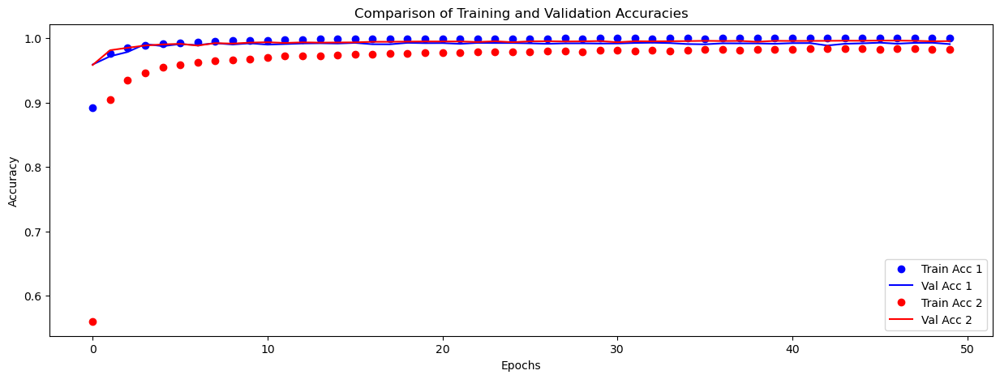

In [26]:
# Compare the accuracies of three training processes
acc1 = history1.history['acc']
val_acc1 = history1.history['val_acc']
acc2 = history2.history['acc']
val_acc2 = history2.history['val_acc']

PlotTwoAccuracyComparison(acc1, val_acc1, acc2, val_acc2, 'Model 1', 'Model 2')

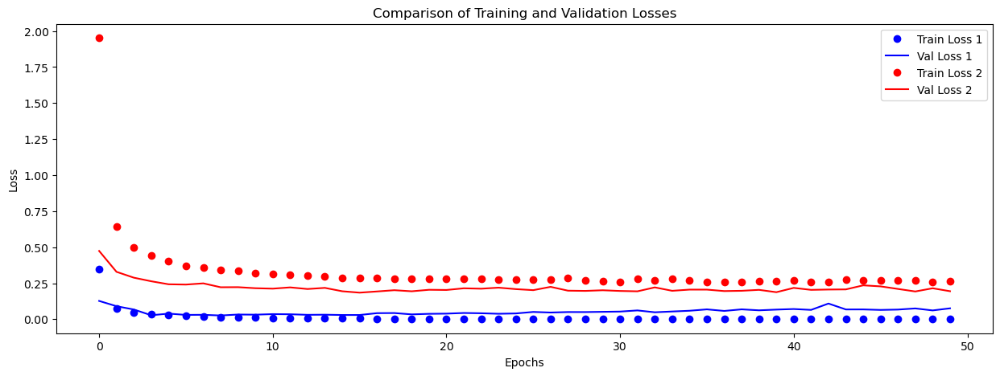

In [27]:
# Compare the losses of three training processes
loss1 = history1.history['loss']
val_loss1 = history1.history['val_loss']
loss2 = history2.history['loss']
val_loss2 = history2.history['val_loss']

PlotTwoLossComparison(loss1, val_loss1, loss2, val_loss2, 'Model 1', 'Model 2')

In [28]:
LABELS= ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9']

# Define the confusion matrix for the results
def show_confusion_matrix(validations, predictions, num_classes):
    matrix = metrics.confusion_matrix(validations, predictions)
    plt.figure(figsize=(num_classes, num_classes))
    hm = sns.heatmap(matrix,
                cmap='coolwarm',
                linecolor='white',
                linewidths=1,
                xticklabels=LABELS,
                yticklabels=LABELS,
                annot=True,
                fmt='d')
    plt.yticks(rotation = 0)  # Don't rotate (vertically) the y-axis labels
    #hm.invert_yaxis() # Invert the labels of the y-axis
    hm.set_ylim(0, len(matrix))
    plt.title('Confusion Matrix')
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.show()

Validation loss: 0.1945229321718216
Validation accuracy: 0.9954000115394592


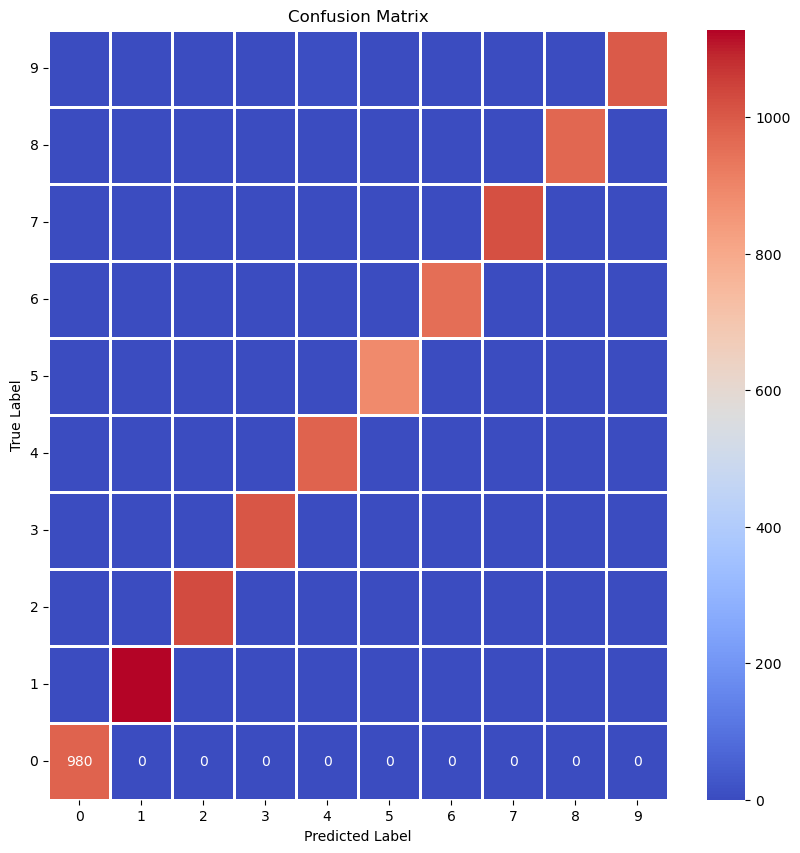

              precision    recall  f1-score   support

           0       0.99      1.00      1.00       980
           1       0.99      0.99      0.99      1135
           2       1.00      1.00      1.00      1032
           3       1.00      1.00      1.00      1010
           4       0.99      1.00      1.00       982
           5       1.00      0.99      0.99       892
           6       1.00      1.00      1.00       958
           7       0.99      0.99      0.99      1028
           8       1.00      1.00      1.00       974
           9       1.00      0.99      0.99      1009

    accuracy                           1.00     10000
   macro avg       1.00      1.00      1.00     10000
weighted avg       1.00      1.00      1.00     10000



In [29]:
# Evaluate the model and print out the final scores for the val set
score = model2.evaluate(x_val, y_val, verbose=0)  # evaluate the model on the val set
print('Validation loss:', score[0])      # print out the loss = score[0] (generalization error) 
print('Validation accuracy:', score[1])  # print out the generalization accuracy = score[1] of the model on val set

# Use the trained model for predictions of the val data (in this case, we use validation data as val data)
y_pred_val = model2.predict(x_val)

# Take the class with the highest probability from the val predictions as a winning one
max_y_pred_val = np.argmax(y_pred_val, axis=1)
max_y_val = np.argmax(y_val, axis=1)

# Show the confution matrix of the collected results
show_confusion_matrix(max_y_val, max_y_pred_val, num_classes)

# Print classification report
print(classification_report(max_y_val, max_y_pred_val))

Number of misclassified examples:  46
Misclassified examples:
[ 359  582  659  716  947 1039 1112 1226 1232 1260 1790 1878 1901 2035
 2040 2130 2414 2454 2462 2597 2995 3422 3808 3869 4078 4201 4497 4507
 4740 4761 4823 5654 5937 5997 6571 6576 7847 7856 7928 8059 8376 9638
 9642 9692 9698 9729]
Misclassified images (original class : predicted class):


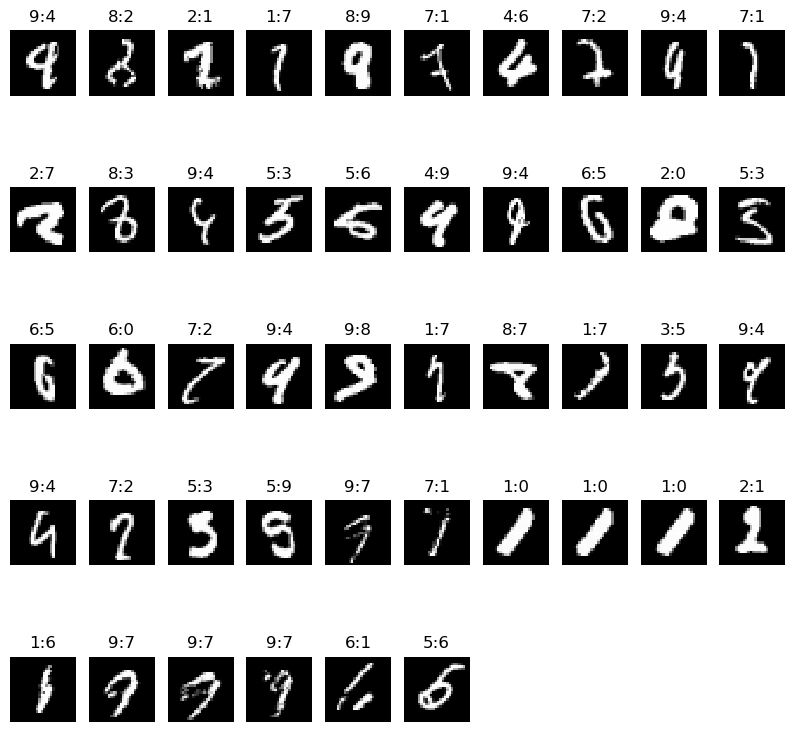

In [30]:
# Find out misclassified examples
classcheck = max_y_val - max_y_pred_val  # 0 - when the class is the same, 1 - otherwise
misclassified = np.where(classcheck != 0)[0]
num_misclassified = len(misclassified)

# Print misclassification report
print('Number of misclassified examples: ', str(num_misclassified))
print('Misclassified examples:')
print(misclassified)

# Show misclassified examples:
print('Misclassified images (original class : predicted class):')
plt.rcParams['figure.figsize'] = (2.5, 2.5) # set default size of plots
col = 10
row = 2 * math.ceil(num_misclassified / col)
fig = plt.figure(figsize=(col, row))
for index in range(0,num_misclassified):
    fig.add_subplot(row, col, index + 1 + col*(index//col))
    plt.axis('off')
    plt.imshow(x_val[misclassified[index]].reshape(img_rows, img_cols)) # index of the val sample picture
    plt.title(str(max_y_val[misclassified[index]]) + ":" + str(max_y_pred_val[misclassified[index]]))
plt.show()

The comparison of results has shown that our second model achieve higher accuracy than the simple model.

You can still try to change hyperparameters of the model and achieve better results!

## CIFAR-10 dataset training and validation example on ConvNet

Let's look at another example of the convolutional neural network used to classify CIFAR-10 data.

Now, we will use RGB images of 32 x 32 pixels and classify them into 10 classes.

Training data consists of 50000 of images, and validating dataset of 10000 of images.

In [31]:
from keras.datasets import cifar10 # gets CIFAR-10 dataset from repository

# Define hyperparameters
num_classes = 10 # number of classes of images

# Input image dimensions
img_rows, img_cols = 32, 32

# Split the data between train and val sets
(x_train, y_train), (x_val, y_val) = cifar10.load_data() # 50000 training and 10000 validating examples

170500096/170498071 [==============================] - 1352s 8us/step


<Figure size 250x250 with 0 Axes>

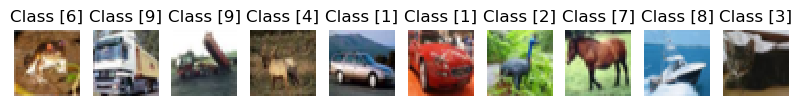

<Figure size 100x100 with 0 Axes>

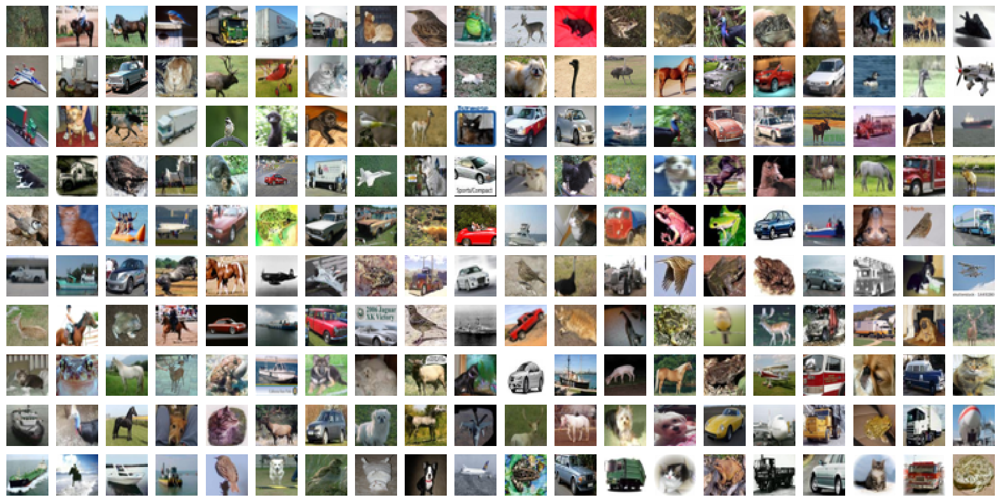

In [32]:
# Show a few sample images from the training set
#plt.rcParams['figure.figsize'] = (2.5, 2.5) # set default size of plots
plt.figure(figsize=(2.5,2.5))
col1 = 10
row1 = 1
fig = plt.figure(figsize=(col1, row1))
for index in range(0, col1*row1):
    fig.add_subplot(row1, col1, index + 1)
    plt.axis('off')
    plt.imshow(x_train[index]) # index of the sample picture
    plt.title("Class " + str(y_train[index]))
plt.show()
    
# Show a few sample digits from the training set
#plt.rcParams['figure.figsize'] = (1.0, 1.0) # set default size of plots
plt.figure(figsize=(1.0,1.0))
col2 = 20
row2 = 10
fig = plt.figure(figsize=(col2, row2))
for index in range(col1*row1, col1*row1 + col2*row2):
    fig.add_subplot(row2, col2, index - col1*row1 + 1)
    plt.axis('off')
    plt.imshow(x_train[index]) # index of the sample picture
plt.show()

In [33]:
# According to the different formats reshape training and validating data
if K.image_data_format() == 'channels_first':
    x_train = x_train.reshape(x_train.shape[0], 3, img_rows, img_cols)
    x_val = x_val.reshape(x_val.shape[0], 3, img_rows, img_cols)
    input_shape = (3, img_rows, img_cols)
else:
    x_train = x_train.reshape(x_train.shape[0], img_rows, img_cols, 3)
    x_val = x_val.reshape(x_val.shape[0], img_rows, img_cols, 3)
    input_shape = (img_rows, img_cols, 3)

# Transform training and validating data and show their shapes
x_train = x_train.astype('float32')   # Copy this array and cast it to a specified type
x_val = x_val.astype('float32')     # Copy this array and cast it to a specified type
x_train /= 255 # Transfrom the training data from the range of 0 and 255 to the range of 0 and 1
x_val /= 255  # Transfrom the validating data from the range of 0 and 255 to the range of 0 and 1
print('x_train shape:', x_train.shape)
print(x_train.shape[0], 'train samples')
print(x_val.shape[0], 'validating samples')

# Convert class vectors to binary class matrices
y_train = tensorflow.keras.utils.to_categorical(y_train, num_classes)
y_val = tensorflow.keras.utils.to_categorical(y_val, num_classes)

x_train shape: (50000, 32, 32, 3)
50000 train samples
10000 validating samples


### Create a model for this dataset

In [34]:
# Define the sequential Keras model composed of a few layers
model3 = Sequential()   # establishes the type of the network model
# Conv2D - creates a convolutional layer (https://keras.io/layers/convolutional/#conv2d) with 
# filters - specified number of convolutional filters
# kernel_size - defines the frame (sliding window) size where the convolutional filter is implemented
# activation - sets the activation function for this layers, here ReLU
# input_shape - defines the shape of the input matrix (vector), here input_shape = (1, img_rows, img_cols)
model3.add(Conv2D(64, kernel_size=(3, 3),activation='relu', input_shape=input_shape))
model3.add(Conv2D(64, (3, 3), activation='relu'))
# MaxPooling2D pools the max value from the frame (sliding window) of 2 x 2 size
model3.add(MaxPooling2D(pool_size=(2, 2)))
model3.add(Dropout(0.25)) # Implements the drop out with the probability of 0.25
model3.add(Conv2D(128, (3, 3), activation='relu',padding='same'))
#model3.add(Conv2D(128, (3, 3), activation='relu',padding='same'))
model3.add(MaxPooling2D(pool_size=(2, 2)))
model3.add(Dropout(0.35))
model3.add(Conv2D(256, (3, 3), activation='relu',padding='same'))
model3.add(MaxPooling2D(pool_size=(2, 2)))
model3.add(Dropout(0.35))
# Finish the convolutional model and flatten the layer which does not affect the batch size.
model3.add(Flatten())
# Use a dense layer (MLP) consisting of 256 neurons with relu activation functions
model3.add(Dense(256, activation='relu', kernel_regularizer=regularizers.l2(0.001))) #512
model3.add(Dropout(0.5))
model3.add(Dense(128, activation='relu', kernel_regularizer=regularizers.l2(0.001))) #256
model3.add(Dropout(0.3))
model3.add(Dense(num_classes, activation='softmax'))

# Now print the full model and notice the number of all trainable paramters
print(model2.summary())

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_3 (Conv2D)            (None, 26, 26, 32)        320       
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 13, 13, 32)        0         
_________________________________________________________________
dropout (Dropout)            (None, 13, 13, 32)        0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 13, 13, 64)        18496     
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 6, 6, 64)          0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 6, 6, 64)          0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 6, 6, 128)        

In [35]:
# Define hyperparameters
batch_size = 512 # size of mini-baches
epochs = 50      # how many times all traing examples will be used to train the model

# Compile the model using optimizer
opt = tensorflow.keras.optimizers.Adam(learning_rate=0.001) #, beta_1=0.9, beta_2=0.999, epsilon=1e-07, amsgrad=False, name="Adam") # https://keras.io/api/optimizers/adam/
#opt = optimizers.Adadelta(learning_rate=0.001, rho=0.95, epsilon=1e-07, name="Adadelta", **kwargs)  # https://keras.io/api/optimizers/adadelta/
#opt = optimizers.Adagrad(learning_rate=0.001, initial_accumulator_value=0.1, epsilon=1e-07, name="Adagrad", **kwargs)  # https://keras.io/api/optimizers/adagrad/
#opt = optimizers.Adamax(learning_rate=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-07, name="Adamax", **kwargs)  # https://keras.io/api/optimizers/adamax/
#opt = optimizers.Nadam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-07, name="Nadam", **kwargs)  # https://keras.io/api/optimizers/Nadam/
#opt = optimizers.Ftrl(learning_rate=0.001, learning_rate_power=-0.5, initial_accumulator_value=0.1, l1_regularization_strength=0.0, l2_regularization_strength=0.0, name="Ftrl", l2_shrinkage_regularization_strength=0.0, beta=0.0, **kwargs)  # https://keras.io/api/optimizers/ftrl/
#opt = optimizers.RMSprop(learning_rate=0.001, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False, name="RMSprop", **kwargs) # https://keras.io/api/optimizers/rmsprop/
#opt = optimizers.SGD(learning_rate=0.01, momentum=0.0, nesterov=False, name="SGD", **kwargs)  # https://keras.io/api/optimizers/sgd/
model3.compile(loss=keras.losses.categorical_crossentropy,
               optimizer=opt,
               metrics=['acc']) # List of metrics to be evaluated by the model during training and validating: https://keras.io/models/model/#compile

# Learning rate reduction durint the training process: https://keras.io/callbacks/#reducelronplateau
learning_rate_reduction = ReduceLROnPlateau(monitor='val_acc', # quantity to be monitored (val_loss)
                                            factor=0.5, # factor by which the learning rate will be reduced. new_lr = lr * factor
                                            patience=5, # number of epochs that produced the monitored quantity with no improvement after which training will be stopped
                                            verbose=1,  # 0: quiet, 1: update messages.
                                            min_lr=0.001) # lower bound on the learning rate

# Augmentation of training data. It generates batches of tensor image data with real-time data augmentation. The data will be looped over in batches.
datagen = ImageDataGenerator(
          rotation_range=20,       # rotate images in degrees up to the given degrees
          width_shift_range=0.1,   # shift images horizontally
          height_shift_range=0.1,  # shift images vertically
          horizontal_flip=True)    # flip images (left<->right)
# Computes the internal data stats related to the data-dependent transformations, based on an array of samples x_train
datagen.fit(x_train)

# Train the model, validate, evaluate, and present scores
#history=model3.fit_generator(datagen.flow(x_train, y_train, batch_size=batch_size),
history=model3.fit(datagen.flow(x_train, y_train, batch_size=batch_size),
                            epochs=epochs,
                            steps_per_epoch=x_train.shape[0]//batch_size,  # no of mini-batches 
                            validation_data=(x_val, y_val),
                            verbose=1,
                            callbacks=[learning_rate_reduction])

Epoch 1/50
97/97 [==============================] - 64s 531ms/step - loss: 2.5794 - acc: 0.1628 - val_loss: 1.9340 - val_acc: 0.3206
Epoch 2/50
97/97 [==============================] - 28s 286ms/step - loss: 1.8895 - acc: 0.3306 - val_loss: 1.6056 - val_acc: 0.4482
Epoch 3/50
97/97 [==============================] - 28s 285ms/step - loss: 1.6966 - acc: 0.4041 - val_loss: 1.4093 - val_acc: 0.5163
Epoch 4/50
97/97 [==============================] - 28s 289ms/step - loss: 1.5546 - acc: 0.4612 - val_loss: 1.3395 - val_acc: 0.5545
Epoch 5/50
97/97 [==============================] - 28s 287ms/step - loss: 1.4568 - acc: 0.5028 - val_loss: 1.2493 - val_acc: 0.5842
Epoch 6/50
97/97 [==============================] - 28s 287ms/step - loss: 1.3994 - acc: 0.5293 - val_loss: 1.1510 - val_acc: 0.6291
Epoch 7/50
97/97 [==============================] - 28s 286ms/step - loss: 1.3534 - acc: 0.5543 - val_loss: 1.0938 - val_acc: 0.6498
Epoch 8/50
97/97 [==============================] - 28s 286ms/step - 

In [36]:
# Save weights of the model before training to enable to start training it again
model3.save(models_dir + 'CNN_CIFAR-10_1.h5')

Train loss: 0.5845988392829895
Train accuracy: 0.8378199934959412
Bias: 0.8378199934959412
Validation loss: 0.6546604037284851
Validation accuracy: 0.8148000240325928
Variance: -0.02301996946334839


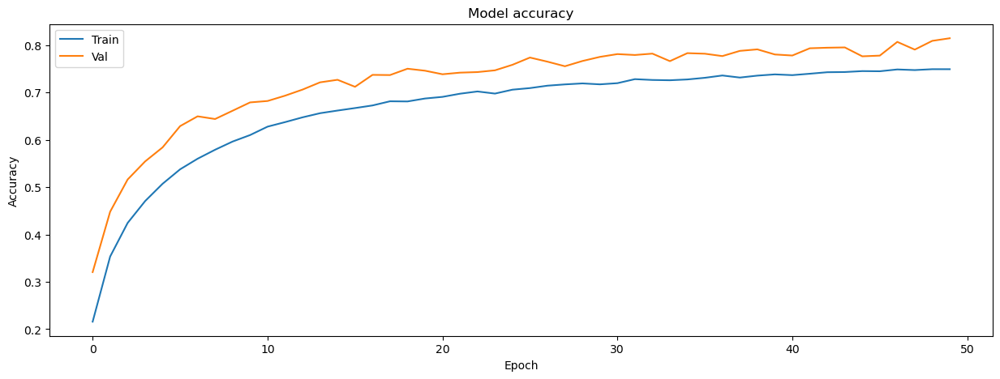

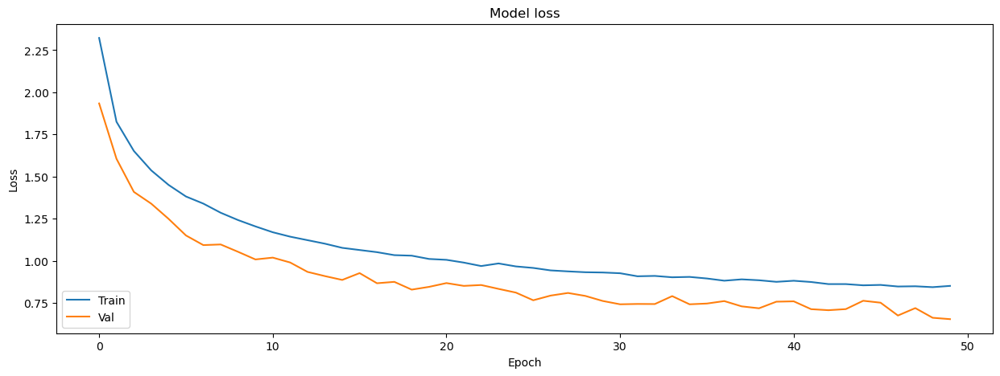

In [37]:
score_train = model3.evaluate(x_train, y_train, verbose=0)
print('Train loss:', score_train[0])
print('Train accuracy:', score_train[1])
print('Bias:', score_train[1])   # Assuming that the Bayes optimal error is equal to 0.

score_val = model3.evaluate(x_val, y_val, verbose=0)
print('Validation loss:', score_val[0])
print('Validation accuracy:', score_val[1])
print('Variance:', score_val[1] - score_train[1])

plt.rcParams['figure.figsize'] = (15.0, 5.0) # set default size of plots

# Plot training & validation accuracy values: https://keras.io/visualization/#training-history-visualization
plt.plot(history.history['acc'])
plt.plot(history.history['val_acc'])
plt.title('Model accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Val'], loc='upper left')  # OR plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plot training & validation loss values: https://keras.io/visualization/#training-history-visualizatio
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Val'], loc='lower left')  # OR plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

As we can notice, the variance is negative (less than 0). Should we be happy about this? Where it comes from? Mini-batch mode and regularization mechanisms, such as Dropout and L1/L2 weight regularization, are turned off at the validation time, so the model does not change as during the testing time. That is why the training error is always bigger, which can appear weird in view of the classic machine learning models. On the other hand, such calculated variance is not true. We had to calculate it without the turned-on regularization factors and with one batch to be comparable to the error calculated for testing data.

The training and validation errors still decrease, so the training should be continued to achieve probably better results, decreasing bias, which is after 50 epochs not satisfactory!

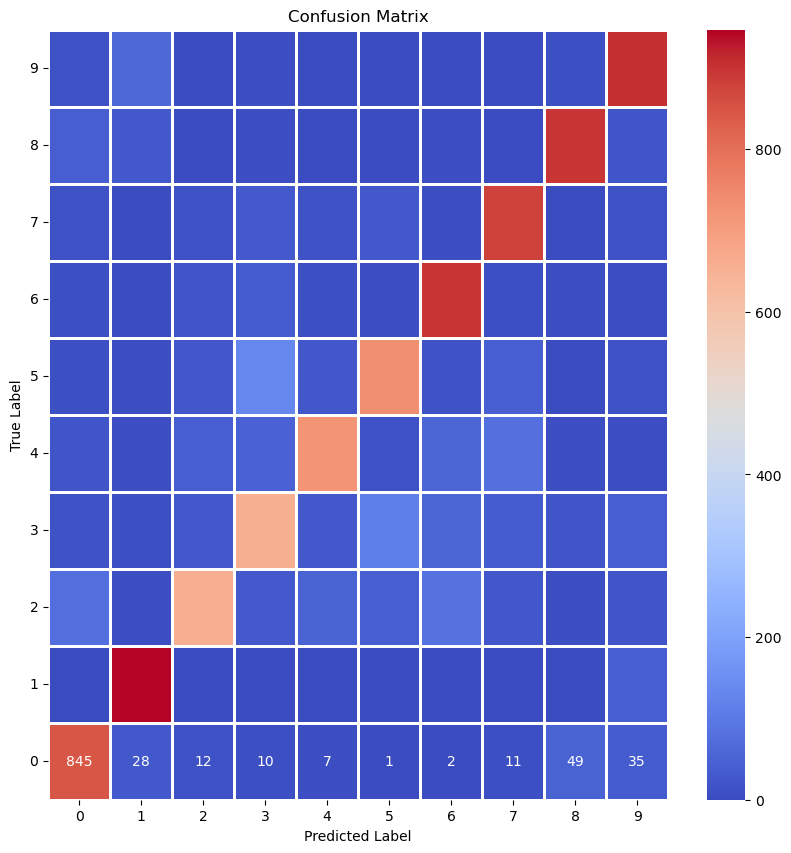

              precision    recall  f1-score   support

           0       0.81      0.84      0.83      1000
           1       0.87      0.95      0.91      1000
           2       0.82      0.66      0.73      1000
           3       0.69      0.66      0.67      1000
           4       0.84      0.72      0.78      1000
           5       0.78      0.73      0.76      1000
           6       0.80      0.90      0.84      1000
           7       0.81      0.88      0.84      1000
           8       0.90      0.90      0.90      1000
           9       0.83      0.91      0.86      1000

    accuracy                           0.81     10000
   macro avg       0.81      0.81      0.81     10000
weighted avg       0.81      0.81      0.81     10000



In [38]:
# Use the trained model for predictions of the val data (in this case, we use validation data as val data)
y_pred_val = model3.predict(x_val)

# Take the class with the highest probability from the val predictions as a winning one
max_y_pred_val = np.argmax(y_pred_val, axis=1)
max_y_val = np.argmax(y_val, axis=1)

# Show the confution matrix of the collected results
show_confusion_matrix(max_y_val, max_y_pred_val, num_classes)

# Print classification report
print(classification_report(max_y_val, max_y_pred_val))

Number of misclassified examples:  1852
Misclassified examples:
[  24   26   32 ... 9985 9989 9993]
Misclassified images (original class : predicted class):


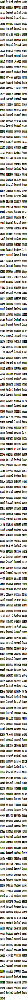

In [39]:
# Find out misclassified examples
classcheck = max_y_val - max_y_pred_val  # 0 - when the class is the same, 1 - otherwise
misclassified = np.where(classcheck != 0)[0]
num_misclassified = len(misclassified)

# Print misclassification report
print('Number of misclassified examples: ', str(num_misclassified))
print('Misclassified examples:')
print(misclassified)

# Show misclassified examples:
print('Misclassified images (original class : predicted class):')
plt.rcParams['figure.figsize'] = (2.5, 2.5) # set default size of plots
col = 10
row = 2 * math.ceil(num_misclassified / col)
fig = plt.figure(figsize=(col, row))
for index in range(0,num_misclassified):
    fig.add_subplot(row, col, index + 1 + col*(index//col))
    plt.axis('off')
    plt.imshow(x_val[misclassified[index]]) # index of the validation sample picture
    plt.title(str(max_y_val[misclassified[index]]) + ":" + str(max_y_pred_val[misclassified[index]]))
plt.show()

As we could see, training this dataset is not so easy as training the MNIST dataset.

The bias of the model is still high, so the model under fits. However, the variance of the model seems not to be bad; however, we didn't calculate the real variance here, so it can be misleading! So, what do we need to do now with this model to reduce the high bias? Let's learn the same model longer (for another hundred of epochs) and change the mini-batch size from 512 to 256 to give the model the ability not to stack in local minima or saddle points so quickly.

So now we apply __a babysitting model__ (__Panda strategy__) to improve the model performance:

In [40]:
# Define hyperparameters
batch_size = 256  # size of mini-baches
epochs = 100      # how many times all traing examples will be used to train this model further

# Compile the model using optimizer
model3.compile(loss=keras.losses.categorical_crossentropy,
               optimizer=keras.optimizers.Adadelta(),
               metrics=['acc']) # List of metrics to be evaluated by the model during training and validating: https://keras.io/models/model/#compile

# Learning rate reduction durint the training process: https://keras.io/callbacks/#reducelronplateau
learning_rate_reduction = ReduceLROnPlateau(monitor='val_acc', # quantity to be monitored (val_loss)
                                            factor=0.5, # factor by which the learning rate will be reduced. new_lr = lr * factor
                                            patience=5, # number of epochs that produced the monitored quantity with no improvement after which training will be stopped
                                            verbose=1,  # 0: quiet, 1: update messages.
                                            min_lr=0.001) # lower bound on the learning rate

# Augmentation of training data. It generates batches of tensor image data with real-time data augmentation. The data will be looped over in batches.
datagen = ImageDataGenerator(
          rotation_range=20,       # rotate images in degrees up to the given degrees
          width_shift_range=0.1,   # shift images horizontally
          height_shift_range=0.1,  # shift images vertically
          horizontal_flip=True)    # flip images (left<->right)
# Computes the internal data stats related to the data-dependent transformations, based on an array of samples x_train
datagen.fit(x_train)

# Train the model, validate, evaluate, and present scores
#history=model3.fit_generator(datagen.flow(x_train, y_train, batch_size=batch_size),
history=model3.fit(datagen.flow(x_train, y_train, batch_size=batch_size),
                            epochs=epochs,
                            steps_per_epoch=x_train.shape[0]//batch_size,  # no of mini-batches 
                            validation_data=(x_val, y_val),
                            verbose=1,
                            callbacks=[learning_rate_reduction])

Epoch 1/100
195/195 [==============================] - 61s 227ms/step - loss: 0.8616 - acc: 0.7444 - val_loss: 0.6610 - val_acc: 0.8123
Epoch 2/100
195/195 [==============================] - 29s 149ms/step - loss: 0.8417 - acc: 0.7530 - val_loss: 0.6707 - val_acc: 0.8067
Epoch 3/100
195/195 [==============================] - 29s 149ms/step - loss: 0.8262 - acc: 0.7604 - val_loss: 0.6779 - val_acc: 0.8041
Epoch 4/100
195/195 [==============================] - 29s 149ms/step - loss: 0.8193 - acc: 0.7608 - val_loss: 0.6808 - val_acc: 0.8026
Epoch 5/100
195/195 [==============================] - 29s 149ms/step - loss: 0.8109 - acc: 0.7603 - val_loss: 0.6830 - val_acc: 0.8015
Epoch 6/100
195/195 [==============================] - 29s 149ms/step - loss: 0.8174 - acc: 0.7589 - val_loss: 0.6836 - val_acc: 0.8015

Epoch 00006: ReduceLROnPlateau reducing learning rate to 0.001.
Epoch 7/100
195/195 [==============================] - 29s 149ms/step - loss: 0.8131 - acc: 0.7620 - val_loss: 0.6838 -

In [41]:
# Save weights of the model before training to enable to start training it again
model3.save(models_dir + 'CNN_CIFAR-10_2.h5')

Train loss: 0.5964422821998596
Train accuracy: 0.8311200141906738
Bias: 0.8311200141906738
Validation loss: 0.6706103086471558
Validation accuracy: 0.8082000017166138
Variance: -0.02292001247406006


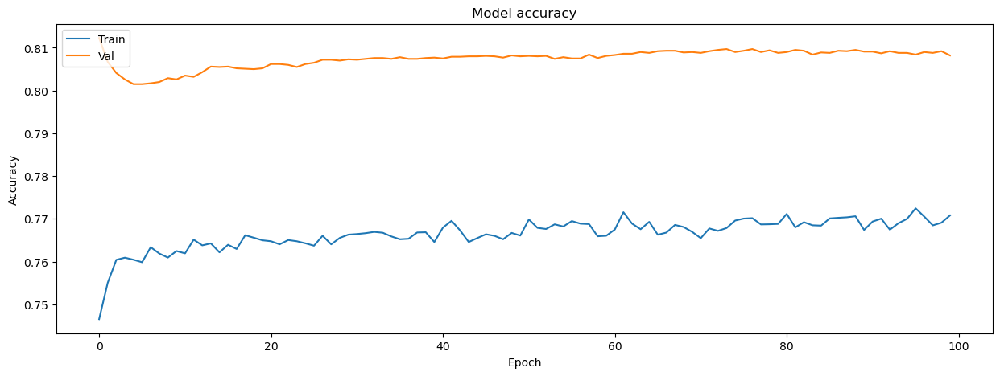

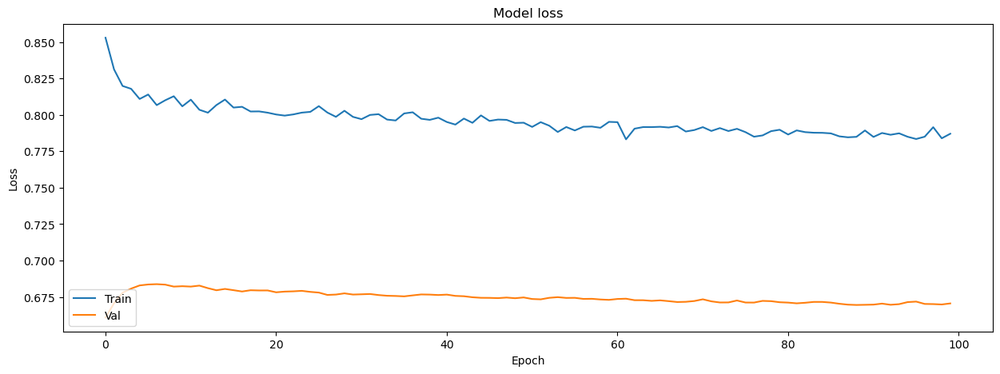

In [42]:
score_train = model3.evaluate(x_train, y_train, verbose=0)
print('Train loss:', score_train[0])
print('Train accuracy:', score_train[1])
print('Bias:', score_train[1])   # Assuming that the Bayes optimal error is equal to 0.

score_val = model3.evaluate(x_val, y_val, verbose=0)
print('Validation loss:', score_val[0])
print('Validation accuracy:', score_val[1])
print('Variance:', score_val[1] - score_train[1])

plt.rcParams['figure.figsize'] = (15.0, 5.0) # set default size of plots

# Plot training & validation accuracy values: https://keras.io/visualization/#training-history-visualization
plt.plot(history.history['acc'])
plt.plot(history.history['val_acc'])
plt.title('Model accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Val'], loc='upper left')  # OR plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plot training & validation loss values: https://keras.io/visualization/#training-history-visualizatio
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Val'], loc='lower left')  # OR plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

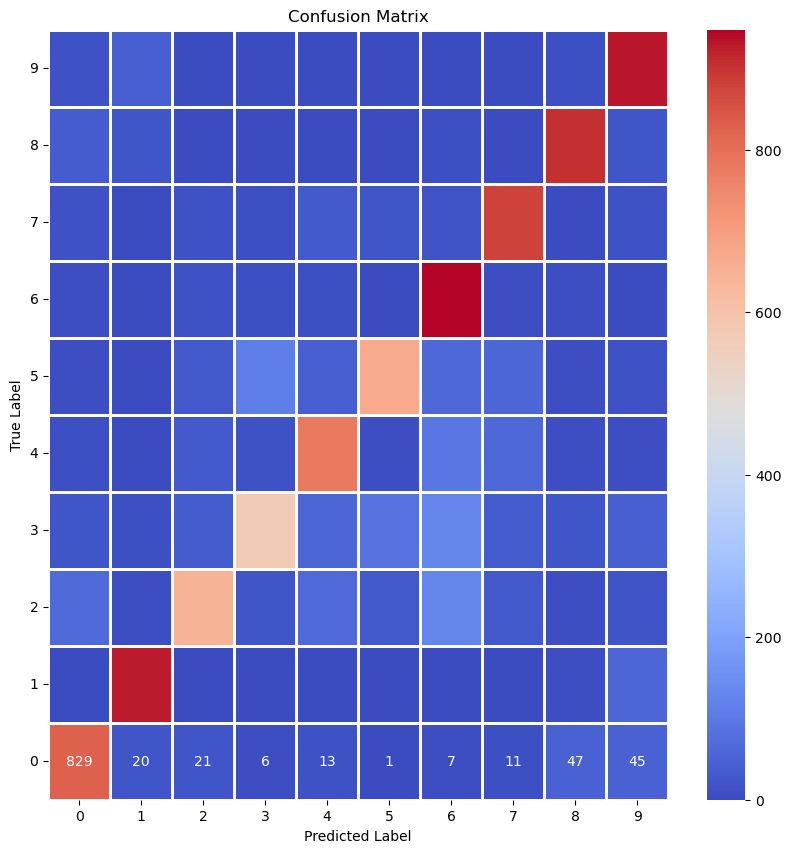

              precision    recall  f1-score   support

           0       0.83      0.83      0.83      1000
           1       0.90      0.93      0.92      1000
           2       0.82      0.65      0.72      1000
           3       0.76      0.57      0.65      1000
           4       0.78      0.78      0.78      1000
           5       0.82      0.67      0.74      1000
           6       0.68      0.95      0.79      1000
           7       0.81      0.88      0.85      1000
           8       0.90      0.91      0.90      1000
           9       0.81      0.93      0.87      1000

    accuracy                           0.81     10000
   macro avg       0.81      0.81      0.80     10000
weighted avg       0.81      0.81      0.80     10000



In [43]:
# Use the trained model for predictions of the val data (in this case, we use validation data as val data)
y_pred_val = model3.predict(x_val)

# Take the class with the highest probability from the val predictions as a winning one
max_y_pred_val = np.argmax(y_pred_val, axis=1)
max_y_val = np.argmax(y_val, axis=1)

# Show the confution matrix of the collected results
show_confusion_matrix(max_y_val, max_y_pred_val, num_classes)

# Print classification report
print(classification_report(max_y_val, max_y_pred_val))

Number of misclassified examples:  1918
Misclassified examples:
[  12   24   25 ... 9989 9993 9996]
Misclassified images (original class : predicted class):


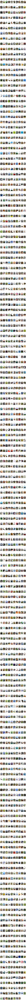

In [44]:
# Find out misclassified examples
classcheck = max_y_val - max_y_pred_val  # 0 - when the class is the same, 1 - otherwise
misclassified = np.where(classcheck != 0)[0]
num_misclassified = len(misclassified)

# Print misclassification report
print('Number of misclassified examples: ', str(num_misclassified))
print('Misclassified examples:')
print(misclassified)

# Show misclassified examples:
print('Misclassified images (original class : predicted class):')
plt.rcParams['figure.figsize'] = (2.5, 2.5) # set default size of plots
col = 10
row = 2 * math.ceil(num_misclassified / col)
fig = plt.figure(figsize=(col, row))
for index in range(0,num_misclassified):
    fig.add_subplot(row, col, index + 1 + col*(index//col))
    plt.axis('off')
    plt.imshow(x_val[misclassified[index]]) # index of the validation sample picture
    plt.title(str(max_y_val[misclassified[index]]) + ":" + str(max_y_pred_val[misclassified[index]]))
plt.show()

After 100 epochs, we increased the model accuracy from 0.81 to 0.85, so the number of incorrectly classified validation examples dropped about a few hundred. Our model is still not perfect. It's time for you! What do you propose to do with this model to perform better than the presented model? Implement your ideas in the following assignments.

## ASSIGNMENTS

* Copy and paste the above-developed model to the cells below.
* Modify hyperparameters of the model (the structure, the number of layers in the network and the number of filters per convolution layer, dropout parameters etc.) and achieve better accuracy for both models: MNIST and CIFAR-10.
* Reduce the high bias of the CIFAR-10 model, not raising or even still decreasing the model variance.
* Compare accuracy and loss of your model with the previously trained models (PlotTwoAccuracyComparison and PlotTwoLossComparison).
* Try to perform similar experiments on a different training dataset of images, e.g. downloaded from <a href="www.kaggle.com">Kaggle.com</a> or a different source. Create a new CNN model and implement regularizations and other optimization methods trying to decrease bias and variance of the model. 

* Send your developed CNN model as an answer to this assignment on MS Teams.

### Solution

First of all a quick look at the training process of the models let us to conclude that they rather were trained just on a cpu without gpu acceleration. That's why author configured local environment, cuda, tensorflow and keras versions with cuda support. On the very top of the file there are some new cells that let test if there is gpu detected and display gpu model. Also in the cell below there is a screenshot from a nvtop tool that allows us to verify that the gpu is utilized. Used gpu has only around 2GB of vram, while colab top tier gpu A100 has up to 80GB of vram, but performance boost is significant. In the training process where original notebook reports 130-140s per epoch we achieve 29s per epoch, so a full model training takes 30 minutes instead of 4 hours.

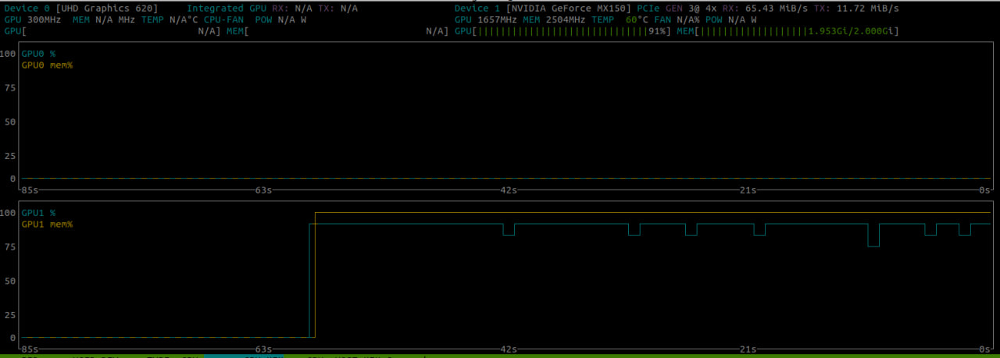

In [54]:
!nvidia-smi

Wed Mar 13 22:25:58 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.161.07             Driver Version: 535.161.07   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce MX150           On  | 00000000:01:00.0 Off |                  N/A |
| N/A   48C    P8              N/A / ERR! |   1952MiB /  2048MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [5]:
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

Num GPUs Available:  1


### Mnist

2024-03-13 23:58:37.300386: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1


Train (60000, 28, 28) (60000,)
Test (10000, 28, 28) (10000,)


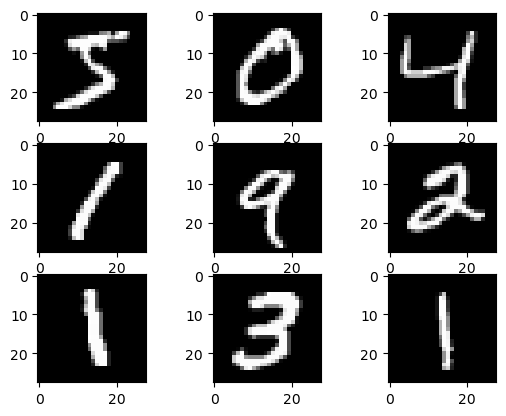

[5 0 4 1 9 2 1 3 1]


In [3]:
from keras.datasets import mnist
import matplotlib.pyplot as plt

# load the dataset
(trainX, trainy), (testX, testy) = mnist.load_data()

# summarize the shape of the dataset
print('Train', trainX.shape, trainy.shape)
print('Test', testX.shape, testy.shape)

# plot first few images and print labels
for i in range(9):
    plt.subplot(330 + 1 + i)
    plt.imshow(trainX[i], cmap=plt.get_cmap('gray'))

plt.show()
print(trainy[:9])

In [4]:
# define convolutional neural network model

# reshape data to have a single channel
trainX = trainX.reshape((trainX.shape[0], 28, 28, 1))
testX = testX.reshape((testX.shape[0], 28, 28, 1))

# convert from integers to floats
trainX, testX = trainX.astype('float32'), testX.astype('float32')

# normalize to range 0-1
trainX, testX = trainX / 255.0, testX / 255.0

In [5]:
import keras

# if model exists load from file
if os.path.exists(models_dir + 'my-mnist-model.h5'):
    model = keras.models.load_model(models_dir + 'my-mnist-model.h5')
    print('Model loaded from file')

2024-03-13 23:58:41.703721: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set


Model loaded from file


2024-03-13 23:58:41.704628: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2024-03-13 23:58:41.719754: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2024-03-13 23:58:41.719911: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: NVIDIA GeForce MX150 computeCapability: 6.1
coreClock: 1.341GHz coreCount: 3 deviceMemorySize: 1.95GiB deviceMemoryBandwidth: 37.33GiB/s
2024-03-13 23:58:41.719934: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2024-03-13 23:58:41.721635: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublas.so.10
2024-03-13 23:58:41.721711: I tensorflow/stream_executor/platform

In [15]:
# define model

model = Sequential()
model.add(Conv2D(6, (5, 5), activation='relu', input_shape=(28, 28, 1)))
model.add(MaxPooling2D((2, 2)))
model.add(Conv2D(16, (5, 5), activation='relu'))
model.add(MaxPooling2D((2, 2)))
model.add(Flatten())
model.add(Dense(120, activation='relu'))
model.add(Dense(84, activation='relu'))
model.add(Dense(10, activation='softmax'))


Pretty basic model, making a model fancy is dangerous as it tends to overfit.

In [16]:
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# fit model
history = model.fit(trainX, trainy, epochs=15, batch_size=256, verbose=2, validation_data=(testX, testy))

Epoch 1/15
235/235 - 2s - loss: 0.4466 - accuracy: 0.8735 - val_loss: 0.1180 - val_accuracy: 0.9634
Epoch 2/15
235/235 - 2s - loss: 0.1082 - accuracy: 0.9681 - val_loss: 0.0669 - val_accuracy: 0.9795
Epoch 3/15
235/235 - 2s - loss: 0.0775 - accuracy: 0.9766 - val_loss: 0.0557 - val_accuracy: 0.9827
Epoch 4/15
235/235 - 2s - loss: 0.0594 - accuracy: 0.9820 - val_loss: 0.0516 - val_accuracy: 0.9825
Epoch 5/15
235/235 - 2s - loss: 0.0493 - accuracy: 0.9852 - val_loss: 0.0375 - val_accuracy: 0.9872
Epoch 6/15
235/235 - 2s - loss: 0.0405 - accuracy: 0.9878 - val_loss: 0.0333 - val_accuracy: 0.9897
Epoch 7/15
235/235 - 2s - loss: 0.0364 - accuracy: 0.9889 - val_loss: 0.0314 - val_accuracy: 0.9894
Epoch 8/15
235/235 - 2s - loss: 0.0314 - accuracy: 0.9901 - val_loss: 0.0311 - val_accuracy: 0.9895
Epoch 9/15
235/235 - 2s - loss: 0.0277 - accuracy: 0.9913 - val_loss: 0.0301 - val_accuracy: 0.9905
Epoch 10/15
235/235 - 2s - loss: 0.0243 - accuracy: 0.9921 - val_loss: 0.0292 - val_accuracy: 0.9901

I've tried multiple combinations of epochs, batch_size and learning rate and this one was one of the best. Increasing a batch_size can lead to the faster training but we also should remember that we may want to increase a learning rate and vice versa: for small batch sizes we may want to decrease learning rate as we don't want a small probe of the dataset to make big impact on the entire dataset.

In [17]:
# evaluate model

loss, acc = model.evaluate(testX, testy, verbose=0)
print('Accuracy: %.3f' % acc)
print('Loss: %.3f' % loss)

Accuracy: 0.990
Loss: 0.032


Looking at the original model we are very close with a slightly smaller loss and much faster training. So the terms of results and learning time it slightly outperforms the original model.

In [18]:
# save model
model.save(models_dir + 'my-mnist-model.h5')

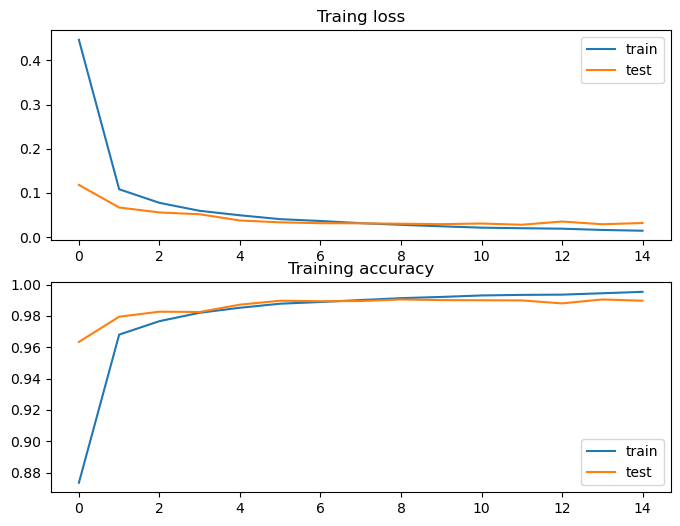

In [19]:
f, ax = plt.subplots(2, 1, figsize=(8, 6))
ax[0].plot(history.history['loss'], label='train')
ax[0].plot(history.history['val_loss'], label='test')
ax[0].legend()
ax[0].set_title('Traing loss')

ax[1].plot(history.history['accuracy'], label='train')
ax[1].plot(history.history['val_accuracy'], label='test')
ax[1].legend()
ax[1].set_title('Training accuracy')

plt.show()

Accuracy and loss plots looks valid and it the curves we see are one we expect to see. No overfitting.

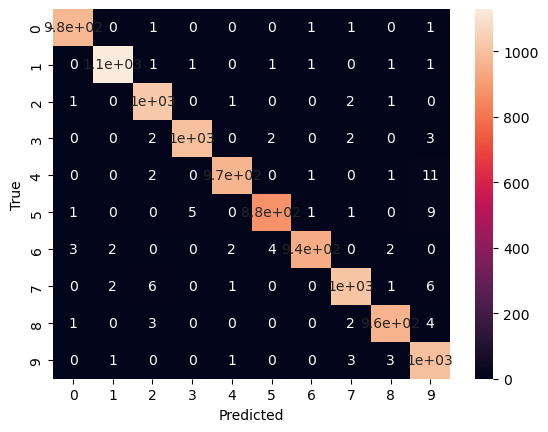

In [26]:
from sklearn.metrics import confusion_matrix

y_prediction = model.predict(testX)
y_prediction = np.argmax(y_prediction, axis = 1)

result = confusion_matrix(testy, y_prediction)
sns.heatmap(result, annot=True)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

Here we see that most images were classified correctly, but at the same that one 2 was classified as 0.

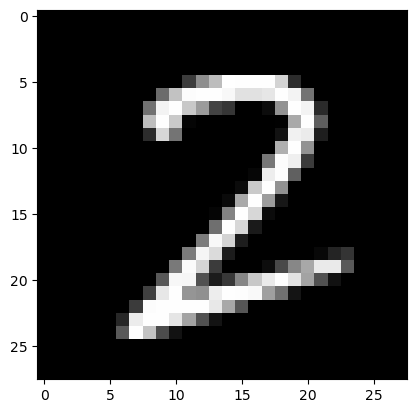

Predicted label: 2


In [23]:
import random

index = random.randint(0, len(testX))
image = testX[index].reshape(28, 28)
plt.imshow(image, cmap='gray')
plt.show()

print('Predicted label:', y_prediction[index])

Example prediction

### CIFAR-10

In [32]:
# load cifar 10 dataset

from keras.datasets import cifar10

(trainX, trainy), (testX, testy) = cifar10.load_data()

trainX, testX = trainX / 255.0, testX / 255.0

Train: X=(50000, 32, 32, 3), y=(50000, 1)
Test: X=(10000, 32, 32, 3), y=(10000, 1)


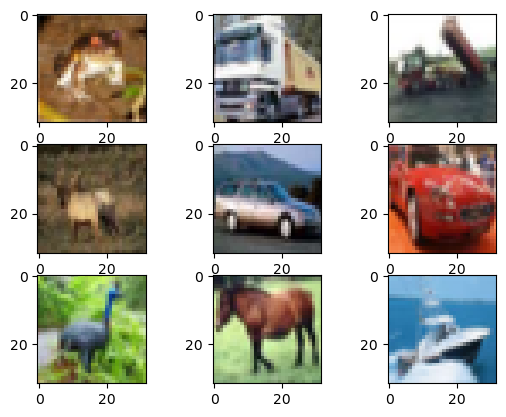

In [33]:
# summarize loaded dataset
print('Train: X=%s, y=%s' % (trainX.shape, trainy.shape))
print('Test: X=%s, y=%s' % (testX.shape, testy.shape))

# plot first few images
for i in range(9):
    plt.subplot(330 + 1 + i)
    plt.imshow(trainX[i])

CIFAR-10 contains colorful images 32x32

In [ ]:
import keras

# if model exists load from file
if os.path.exists(models_dir + 'my-cifar10-model.h5'):
    model = keras.models.load_model(models_dir + 'my-cifar10-model.h5')
    print('Model loaded from file')

In [37]:
# define cnn model

model = Sequential()
model.add(Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same', input_shape=(32, 32, 3)))
model.add(Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
model.add(MaxPooling2D((2, 2)))
model.add(Dropout(0.2))
model.add(Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
model.add(Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
model.add(MaxPooling2D((2, 2)))
model.add(Dropout(0.2))
model.add(Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
model.add(Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_uniform', padding='same'))
model.add(MaxPooling2D((2, 2)))
model.add(Dropout(0.2))
model.add(Flatten())
model.add(Dense(128, activation='relu', kernel_initializer='he_uniform'))
model.add(Dropout(0.2))
model.add(Dense(10, activation='softmax'))


In [38]:
# compile model

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# fit model
history = model.fit(trainX, trainy, epochs=50, batch_size=64, verbose=2, validation_data=(testX, testy))

2024-03-14 00:12:27.446793: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 614400000 exceeds 10% of free system memory.


Epoch 1/50
782/782 - 57s - loss: 1.6494 - accuracy: 0.3927 - val_loss: 1.2221 - val_accuracy: 0.5565
Epoch 2/50
782/782 - 21s - loss: 1.1485 - accuracy: 0.5940 - val_loss: 0.9557 - val_accuracy: 0.6598
Epoch 3/50
782/782 - 21s - loss: 0.9317 - accuracy: 0.6728 - val_loss: 0.8360 - val_accuracy: 0.7121
Epoch 4/50
782/782 - 21s - loss: 0.8121 - accuracy: 0.7157 - val_loss: 0.7543 - val_accuracy: 0.7379
Epoch 5/50
782/782 - 21s - loss: 0.7325 - accuracy: 0.7471 - val_loss: 0.6942 - val_accuracy: 0.7625
Epoch 6/50
782/782 - 21s - loss: 0.6679 - accuracy: 0.7677 - val_loss: 0.7166 - val_accuracy: 0.7575
Epoch 7/50
782/782 - 21s - loss: 0.6284 - accuracy: 0.7793 - val_loss: 0.6379 - val_accuracy: 0.7834
Epoch 8/50
782/782 - 21s - loss: 0.5836 - accuracy: 0.7969 - val_loss: 0.6620 - val_accuracy: 0.7859
Epoch 9/50
782/782 - 21s - loss: 0.5493 - accuracy: 0.8064 - val_loss: 0.6440 - val_accuracy: 0.7878
Epoch 10/50
782/782 - 21s - loss: 0.5254 - accuracy: 0.8163 - val_loss: 0.6103 - val_accura

In [39]:
# evaluate model

loss, acc = model.evaluate(testX, testy, verbose=0)
print('Accuracy: %.3f' % acc)
print('Loss: %.3f' % loss)

Accuracy: 0.816
Loss: 0.676


Our model performs simmilar to the original models, but....

In [40]:
# save model
model.save(models_dir + 'my-cifar10-model.h5')

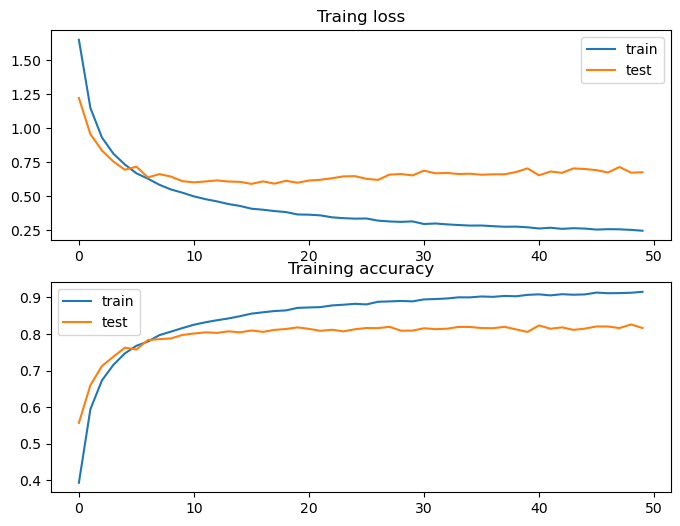

In [41]:
f, ax = plt.subplots(2, 1, figsize=(8, 6))
ax[0].plot(history.history['loss'], label='train')
ax[0].plot(history.history['val_loss'], label='test')
ax[0].legend()
ax[0].set_title('Traing loss')

ax[1].plot(history.history['accuracy'], label='train')
ax[1].plot(history.history['val_accuracy'], label='test')
ax[1].legend()
ax[1].set_title('Training accuracy')

plt.show()

This is interesting case, here we can see decreasing training loss and not changing/increasing test loss. This is clear sign of overfitting. Truth be told while model was learning looking the the losses and accuraces author managed to correctly assume overfitting will happen :)

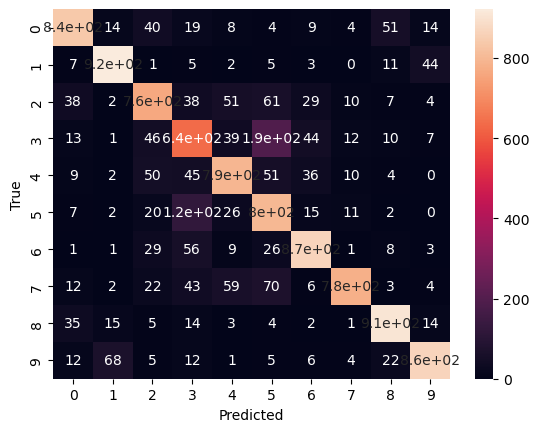

In [42]:
from sklearn.metrics import confusion_matrix

y_prediction = model.predict(testX)
y_prediction = np.argmax(y_prediction, axis = 1)

result = confusion_matrix(testy, y_prediction)
sns.heatmap(result, annot=True)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

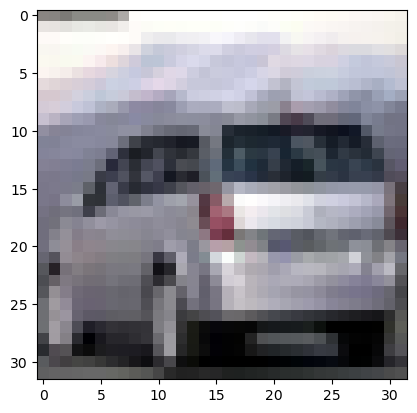

Predicted label: 1


In [48]:
import random

index = random.randint(0, len(testX))
image = testX[index].reshape(32, 32, 3)
plt.imshow(image, cmap='gray')
plt.show()

print('Predicted label:', y_prediction[index])

# get label name for index 4
from keras.datasets import cifar10

(trainX, trainy), (testX, testy) = cifar10.load_data()

# define standard label for cifar 10 dataset


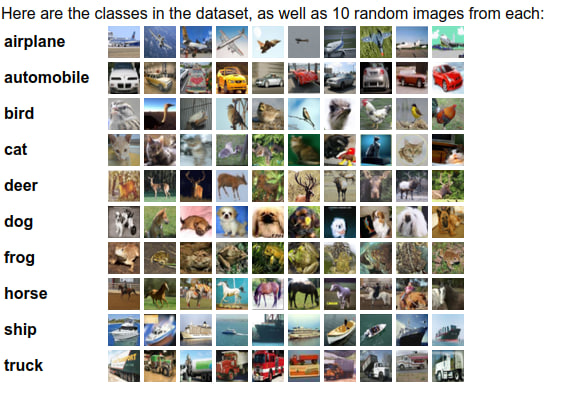

Here we can see that model correctly classified automobile.